In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import numpy as np
from torchvision import transforms
from datasets import load_dataset
from PIL import Image
from torch.utils.data import Dataset
from datasets import load_dataset

from vqvae import VQVAE

/usr/local/lib/python3.10/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [53]:
class ImageDataset(Dataset):
    def __init__(self, hf_dataset, transform=None):
        self.dataset = hf_dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]

        if isinstance(item['image'], dict):
            image = item['image']['bytes']
            image = Image.open(io.BytesIO(image))
        elif isinstance(item['image'], bytes):
            image = Image.open(io.BytesIO(item['image']))
        else:
            image = item['image']
            
        if image.mode != 'RGB':
            image = image.convert('RGB')
            
        if self.transform:
            image = self.transform(image)

        return image, item["style"]

In [4]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

hf_dataset = load_dataset("Artificio/WikiArt_Full", split="train")

dataset = ImageDataset(hf_dataset, transform)

In [5]:
data_loader = DataLoader(
    dataset,
    batch_size=64,
    num_workers=4,
    pin_memory=True
)

In [6]:
model = VQVAE().to(device)

model.load_state_dict(torch.load(f"./models/best_model.pth", weights_only=True))

<All keys matched successfully>

In [7]:
model.eval()

LATENT_SIZE = 2 * 32 * 32

latent_stack = np.zeros((1, LATENT_SIZE))

with torch.no_grad():
    for data, _ in data_loader:
        data = data.to(device)
        latents = model.encode(data)
        latents = torch.flatten(latents, start_dim=1).cpu()
        # print(latents.shape)
        latent_stack = np.vstack([latent_stack, latents])
print(latent_stack.shape)

(103251, 2048)


In [8]:
latent_stack = latent_stack[1:]

In [9]:
np.save("latent_space.npy", latent_stack)

In [ ]:
latent_stack = np.load("latent_space.npy")

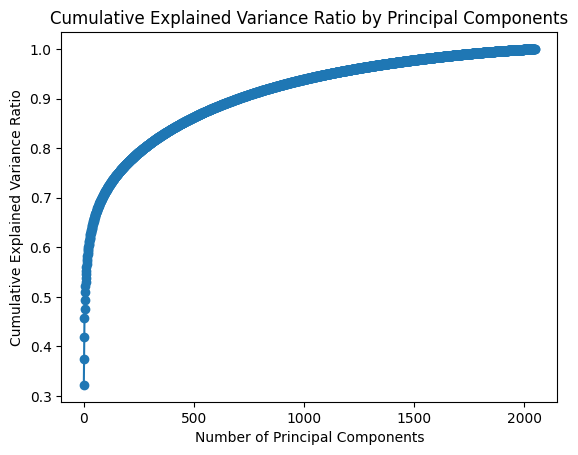

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA()
X_pca = pca.fit_transform(latent_stack)

# Explained variance
explained_variance = pca.explained_variance_
total_explained_variance = explained_variance.sum()

explained_variance_ratio = pca.explained_variance_ratio_

# Plot explained variance ratio
cumulative_variance_ratio = np.cumsum(explained_variance_ratio)
plt.plot(cumulative_variance_ratio, marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio by Principal Components')
plt.show()

In [12]:
# First index with explaned variance above 90%
n_components = np.argmax(np.cumsum(explained_variance_ratio) > 0.9)
print(n_components)

701


In [13]:
from sklearn.decomposition import PCA

pca = PCA(n_components=n_components)

reduced_latent = pca.fit_transform(latent_stack)

In [ ]:
import umap

In [19]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(reduced_latent)

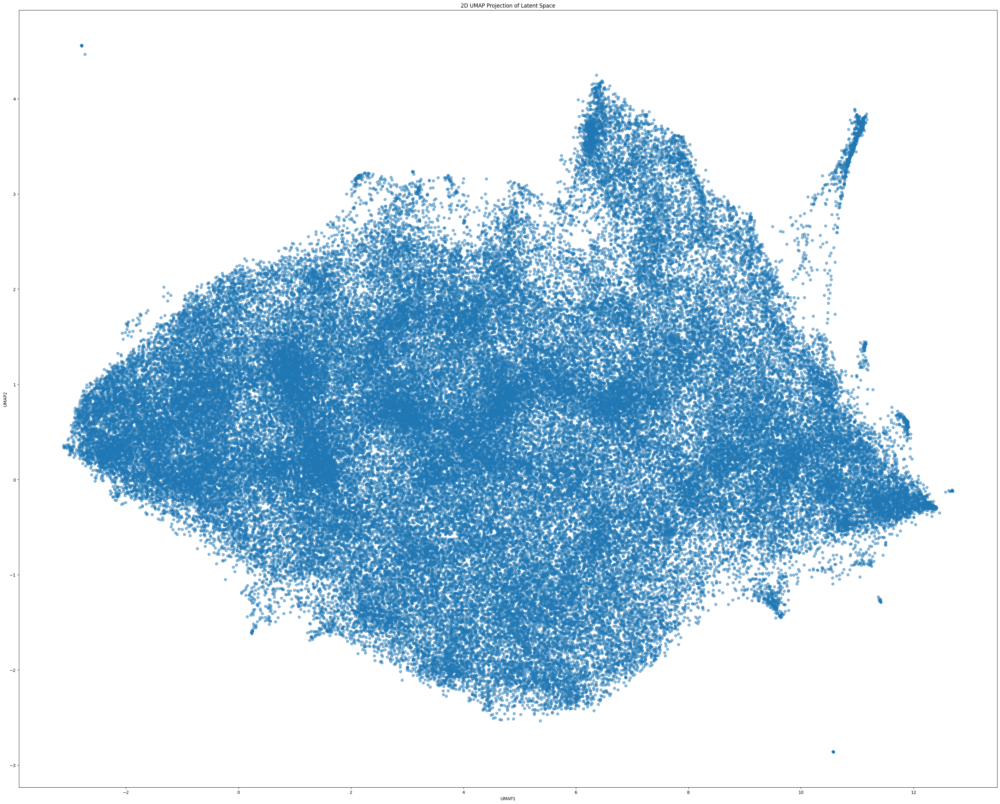

In [20]:
plt.figure(figsize=(40, 32))
plt.scatter(embedding[:, 0], embedding[:, 1], alpha=0.5)
plt.title('2D UMAP Projection of Latent Space')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.show()

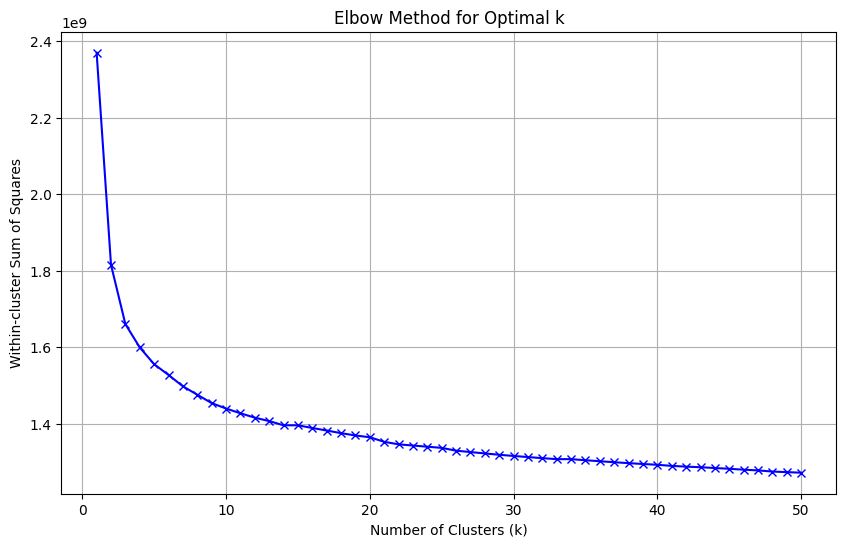


WCSS values:
k=1: 2369460759.21
k=2: 1815098035.70
k=3: 1660126380.38
k=4: 1599242311.52
k=5: 1555488001.01
k=6: 1527385736.96
k=7: 1497686104.12
k=8: 1475809471.73
k=9: 1453807490.57
k=10: 1439639944.80
k=11: 1427234136.64
k=12: 1415758319.47
k=13: 1406839911.04
k=14: 1395807622.30
k=15: 1395788943.47
k=16: 1388815554.59
k=17: 1382168632.63
k=18: 1375294888.82
k=19: 1369248810.37
k=20: 1364571065.58
k=21: 1352650270.34
k=22: 1346084057.82
k=23: 1342951917.61
k=24: 1339853685.73
k=25: 1336810038.58
k=26: 1329537006.12
k=27: 1325899422.14
k=28: 1322273588.17
k=29: 1318817369.15
k=30: 1315694814.11
k=31: 1312839089.87
k=32: 1309936391.82
k=33: 1307383750.25
k=34: 1307332476.60
k=35: 1304519295.10
k=36: 1301894867.62
k=37: 1299308060.42
k=38: 1296885288.56
k=39: 1294692615.35
k=40: 1292615936.22
k=41: 1289735160.33
k=42: 1287784724.93
k=43: 1286256837.79
k=44: 1284134364.23
k=45: 1282210477.00
k=46: 1279800647.65
k=47: 1277961445.73
k=48: 1274933566.28
k=49: 1273447540.27
k=50: 127188627

In [22]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

def plot_elbow(data, max_clusters=50):
    wcss = []  # Within-cluster sum of squares
    K = range(1, max_clusters + 1)
    
    # Calculate WCSS for different numbers of clusters
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        wcss.append(kmeans.inertia_)
    
    # Create elbow plot
    plt.figure(figsize=(10, 6))
    plt.plot(K, wcss, 'bx-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Within-cluster Sum of Squares')
    plt.title('Elbow Method for Optimal k')
    plt.grid(True)
    plt.show()
    
    # Print WCSS values for detailed analysis
    print("\nWCSS values:")
    for k, inertia in zip(K, wcss):
        print(f"k={k}: {inertia:.2f}")

plot_elbow(reduced_latent)

In [51]:
def kmeans_and_umap(data, n_clusters):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(data)
    centers = kmeans.cluster_centers_

    plt.figure(figsize=(40, 32))
    
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], 
                            c=labels, cmap='viridis', 
                            alpha=0.5, s=100)

    plt.title('2D UMAP Projection with Cluster Labels')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.show()

    return labels, centers

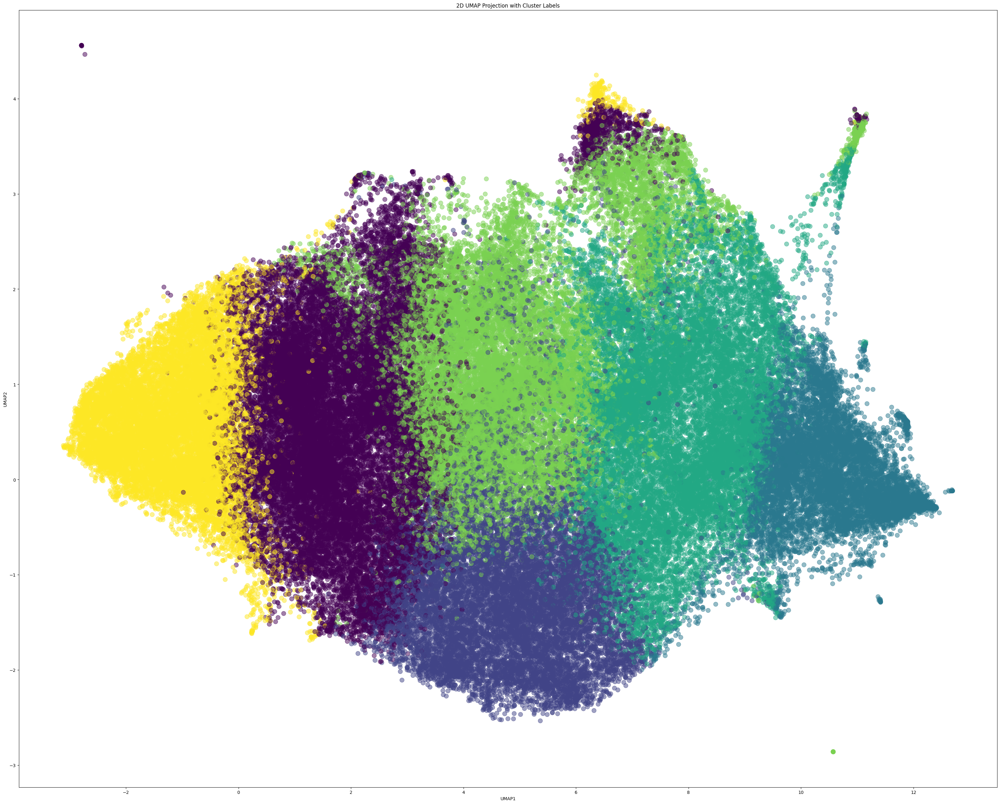

In [52]:
labels, centers = kmeans_and_umap(reduced_latent, 6)

In [60]:
from sklearn.preprocessing import LabelEncoder

real_labels = dataset.dataset["genre"]

label_encoder = LabelEncoder()

real_labels = label_encoder.fit_transform(real_labels)


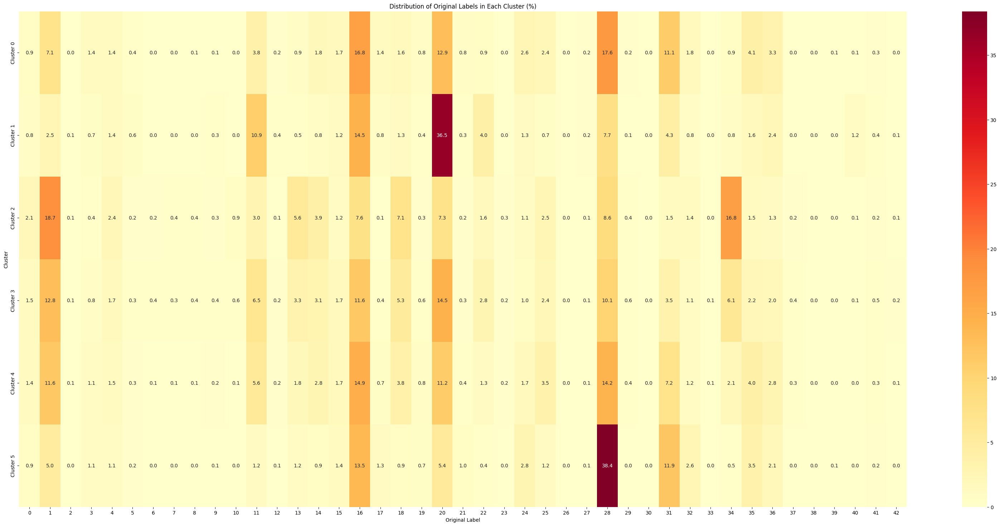


Detailed Cluster Compositions:

Cluster 0 (Total size: 24447)
  28: 4312 (17.64%)
  16: 4105 (16.79%)
  20: 3144 (12.86%)
  31: 2716 (11.11%)
  1: 1739 (7.11%)
  35: 991 (4.05%)
  11: 930 (3.8%)
  36: 798 (3.26%)
  24: 645 (2.64%)
  25: 578 (2.36%)
  14: 447 (1.83%)
  32: 435 (1.78%)
  15: 424 (1.73%)
  18: 391 (1.6%)
  3: 346 (1.42%)
  4: 344 (1.41%)
  17: 343 (1.4%)
  0: 231 (0.94%)
  34: 228 (0.93%)
  22: 225 (0.92%)
  13: 217 (0.89%)
  19: 204 (0.83%)
  21: 199 (0.81%)
  5: 110 (0.45%)
  41: 71 (0.29%)
  27: 52 (0.21%)
  29: 38 (0.16%)
  12: 38 (0.16%)
  9: 32 (0.13%)
  8: 17 (0.07%)
  40: 14 (0.06%)
  39: 13 (0.05%)
  37: 12 (0.05%)
  30: 11 (0.04%)
  23: 10 (0.04%)
  42: 8 (0.03%)
  2: 8 (0.03%)
  10: 7 (0.03%)
  33: 7 (0.03%)
  7: 4 (0.02%)
  26: 3 (0.01%)

Cluster 1 (Total size: 14405)
  20: 5259 (36.51%)
  16: 2094 (14.54%)
  11: 1567 (10.88%)
  28: 1115 (7.74%)
  31: 625 (4.34%)
  22: 581 (4.03%)
  1: 359 (2.49%)
  36: 339 (2.35%)
  35: 232 (1.61%)
  4: 202 (1.4%)
  24: 191 

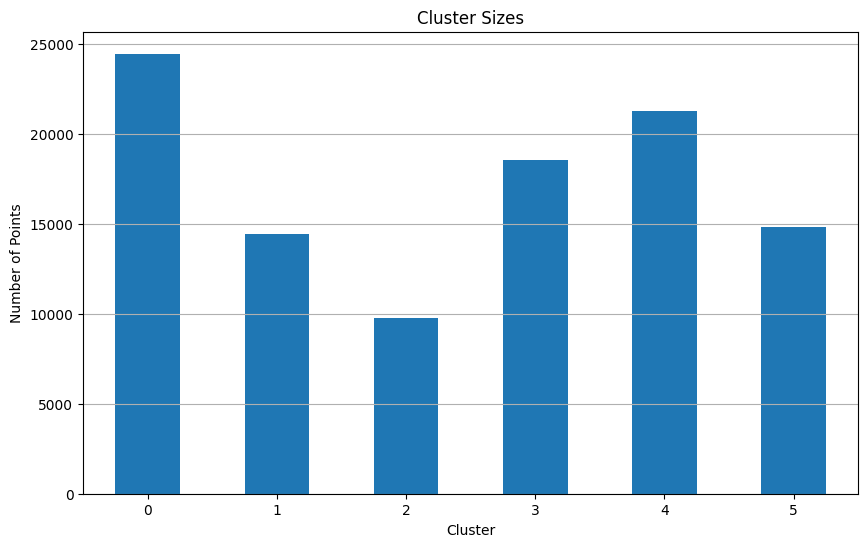

In [68]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import Counter

def analyze_cluster_compositions(cluster_labels, original_labels):
    """
    Analyze and visualize the composition of each cluster in terms of original labels
    
    Parameters:
    -----------
    cluster_labels : array-like
        The cluster assignments from k-means
    original_labels : array-like
        The original ground truth labels
    """
    # Create a DataFrame for easy analysis
    df = pd.DataFrame({
        'Cluster': cluster_labels,
        'Original_Label': original_labels
    })
    
    # Get cluster compositions
    compositions = {}
    for cluster in np.unique(cluster_labels):
        mask = df['Cluster'] == cluster
        cluster_composition = Counter(df[mask]['Original_Label'])
        compositions[f'Cluster {cluster}'] = cluster_composition
    
    # Create a matrix of label distributions
    unique_labels = sorted(set(original_labels))
    distribution_matrix = np.zeros((len(compositions), len(unique_labels)))
    
    for i, (cluster, comp) in enumerate(compositions.items()):
        total = sum(comp.values())
        for j, label in enumerate(unique_labels):
            distribution_matrix[i, j] = comp.get(label, 0) / total * 100

    # Plot heatmap
    plt.figure(figsize=(40, 18))
    sns.heatmap(distribution_matrix,
                xticklabels=unique_labels,
                yticklabels=compositions.keys(),
                annot=True,
                fmt='.1f',
                cmap='YlOrRd')
    plt.title('Distribution of Original Labels in Each Cluster (%)')
    plt.xlabel('Original Label')
    plt.ylabel('Cluster')
    plt.show()

    # Print detailed statistics
    print("\nDetailed Cluster Compositions:")
    for cluster in np.unique(cluster_labels):
        mask = df['Cluster'] == cluster
        cluster_size = mask.sum()
        print(f"\nCluster {cluster} (Total size: {cluster_size})")
        composition = df[mask]['Original_Label'].value_counts()
        percentages = (composition / cluster_size * 100).round(2)
        for label, count in composition.items():
            print(f"  {label}: {count} ({percentages[label]}%)")

    # Plot cluster sizes
    plt.figure(figsize=(10, 6))
    cluster_sizes = df['Cluster'].value_counts().sort_index()
    cluster_sizes.plot(kind='bar')
    plt.title('Cluster Sizes')
    plt.xlabel('Cluster')
    plt.ylabel('Number of Points')
    plt.xticks(rotation=0)
    plt.grid(True, axis='y')
    plt.show()

analyze_cluster_compositions(labels, real_labels)

In [72]:
from collections import defaultdict

def get_random_indices_per_cluster(cluster_labels, n_per_cluster):
    cluster_indices = defaultdict(list)
    for idx, label in enumerate(cluster_labels):
        cluster_indices[label].append(idx)
    
    cluster_indices = {k: np.array(v) for k, v in cluster_indices.items()}
    
    sampled_indices = {}
    for cluster in cluster_indices:
        n_samples = min(n_per_cluster, len(cluster_indices[cluster]))
        sampled_indices[cluster] = np.random.choice(
            cluster_indices[cluster], 
            size=n_samples, 
            replace=False
        )
    
    return sampled_indices

In [73]:
cluster_examples = get_random_indices_per_cluster(labels, 16)

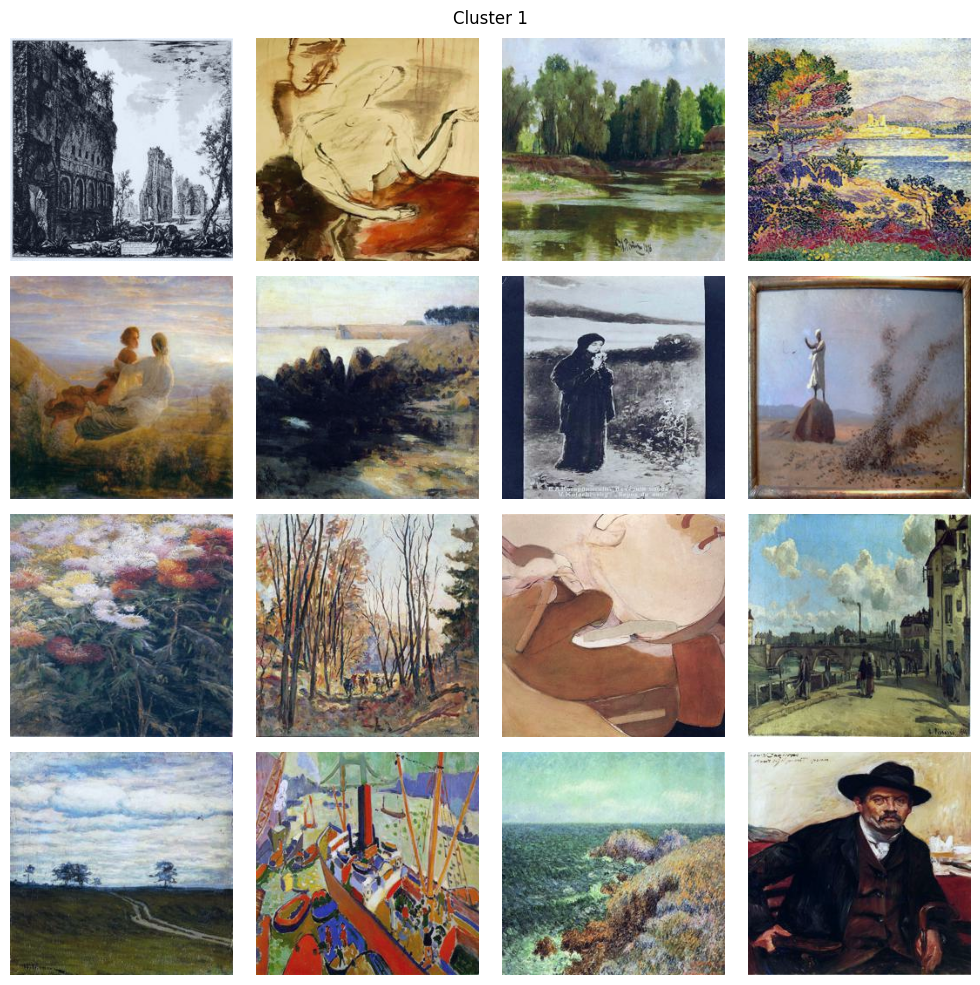

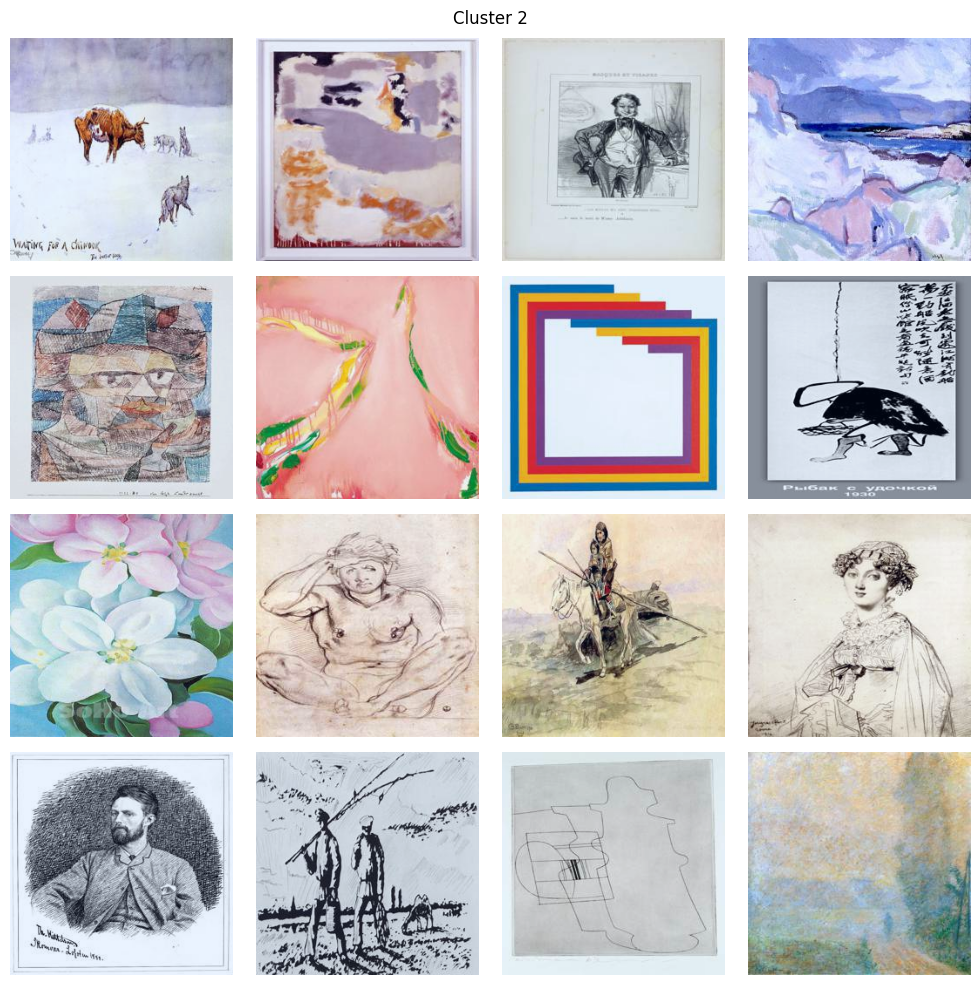

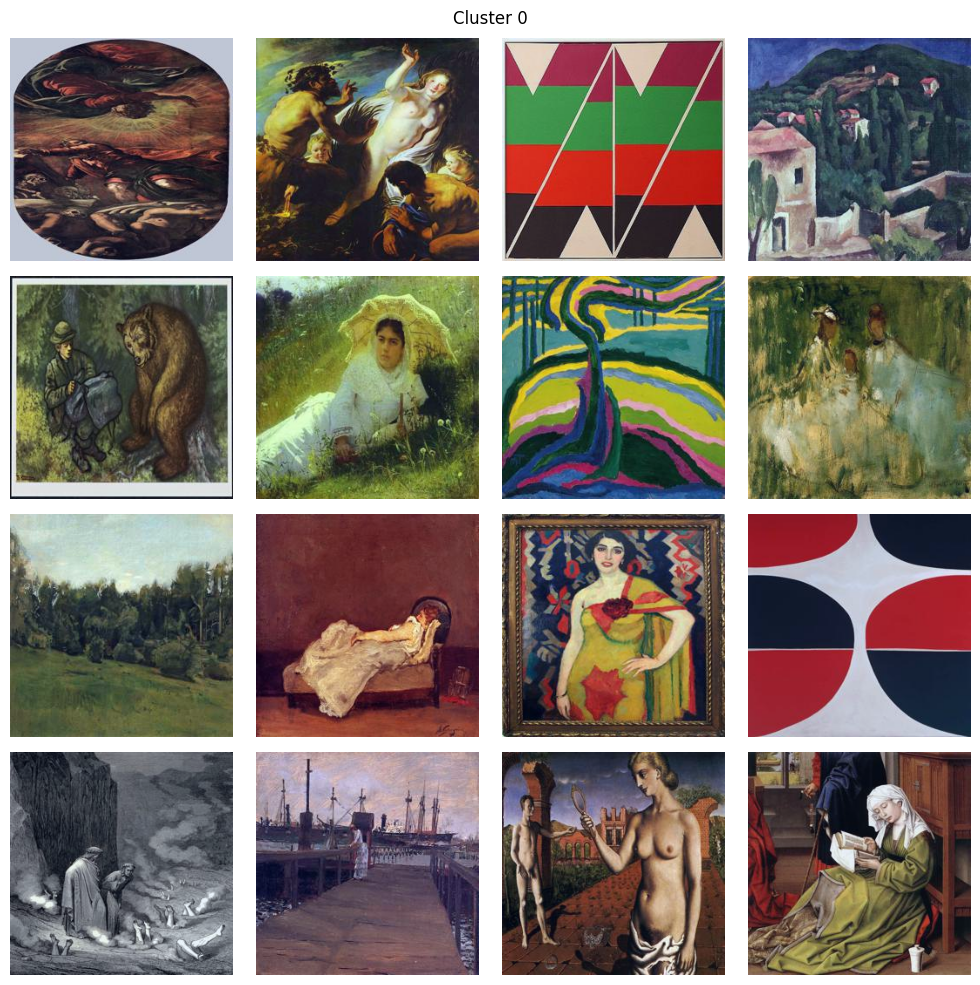

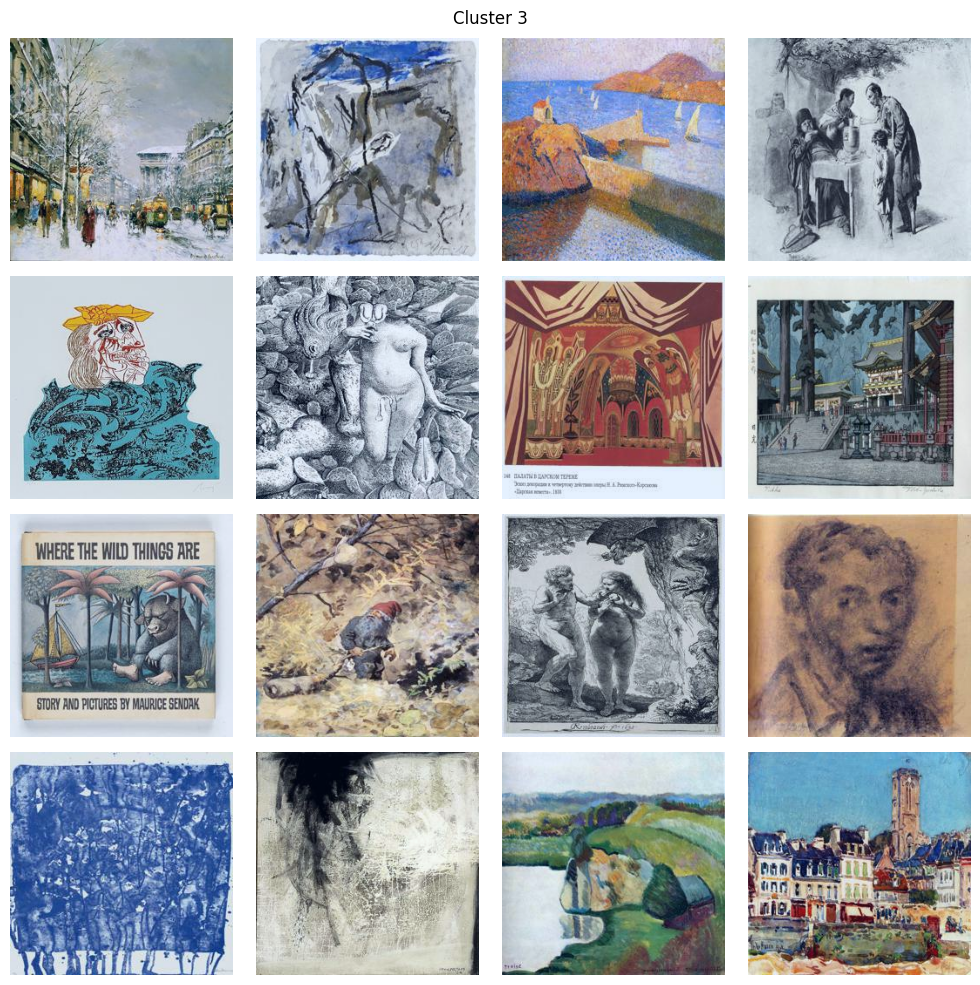

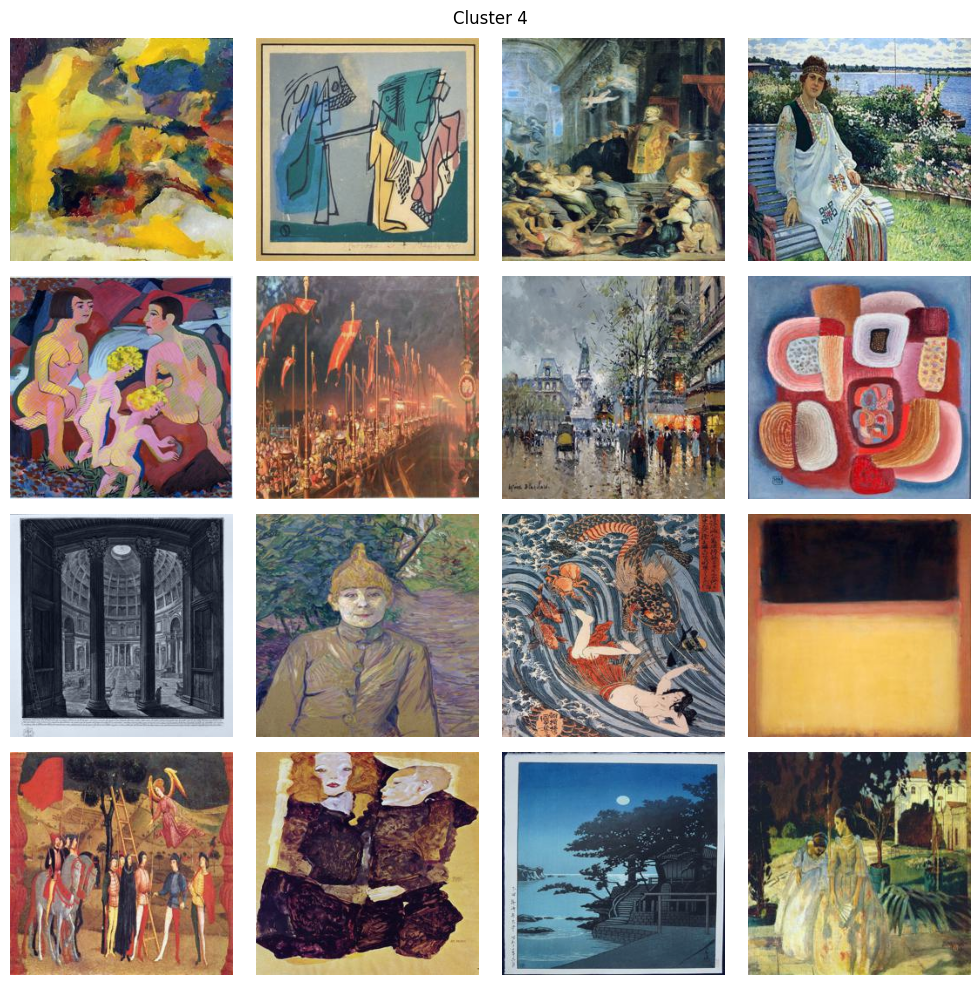

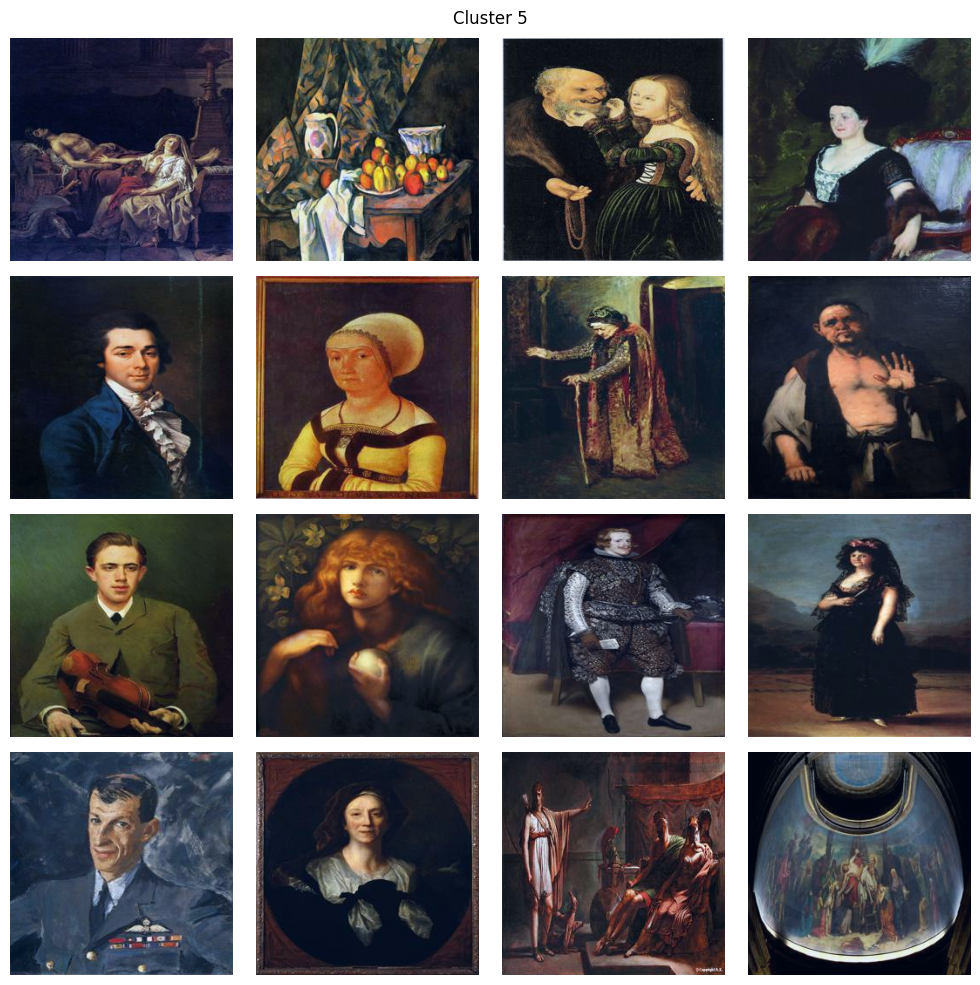

In [85]:
for cluster_idx, indices in cluster_examples.items():
    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
        
    axes_flat = axes.flatten()

    for i, ax in enumerate(axes_flat):
        if i < len(indices):
            img = dataset[int(indices[i])][0].permute(1, 2, 0)
            img = (img - img.min()) / (img.max() - img.min()) * 255
            img = img.to(torch.uint8)
            ax.axis('off')  # Turn off axes
            ax.imshow(img)
        plt.suptitle(f"Cluster {cluster_idx}")

    plt.tight_layout()
    plt.show()